<a href="https://colab.research.google.com/github/seemantobarman/detectron2_segmentation_testing/blob/master/Detectron2_model_testing(still_image).ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [0]:
!pip install -U torch==1.5 torchvision==0.6 -f https://download.pytorch.org/whl/cu101/torch_stable.html 
!pip install cython pyyaml==5.1
!pip install -U 'git+https://github.com/cocodataset/cocoapi.git#subdirectory=PythonAPI'
import torch, torchvision

In [0]:
!pip install detectron2==0.1.3 -f https://dl.fbaipublicfiles.com/detectron2/wheels/cu101/torch1.5/index.html

In [0]:
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

In [0]:
import numpy as np
import cv2
import random
from google.colab.patches import cv2_imshow

In [0]:
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog

--2020-06-02 18:12:33--  http://colorfulroads.net/wp-content/uploads/2018/12/living-the-big-city-life-in-china.jpg
Resolving colorfulroads.net (colorfulroads.net)... 193.32.232.54
Connecting to colorfulroads.net (colorfulroads.net)|193.32.232.54|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 711613 (695K) [image/jpeg]
Saving to: ‘input.jpg’

input.jpg           100%[===================>] 694.93K   511KB/s    in 1.4s    

2020-06-02 18:12:35 (511 KB/s) - ‘input.jpg’ saved [711613/711613]



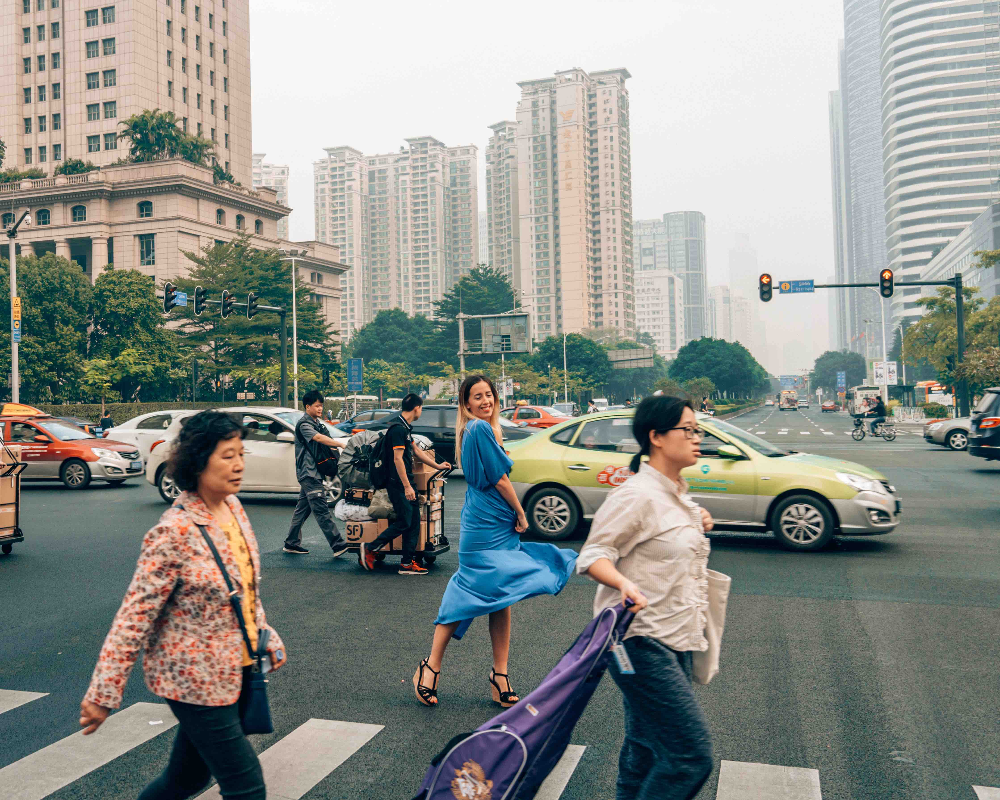

In [15]:
!wget http://colorfulroads.net/wp-content/uploads/2018/12/living-the-big-city-life-in-china.jpg -O input.jpg
im = cv2.imread("./input.jpg")
im = cv2.resize(im, None, fx = 0.5, fy = 0.5, interpolation = cv2.INTER_CUBIC)
cv2_imshow(im)

In [16]:
#Instance Segmentation Model

cfg = get_cfg()

cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"))
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5

cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")
predictor = DefaultPredictor(cfg)
outputs = predictor(im)

model_final_f10217.pkl: 178MB [00:15, 11.2MB/s]                           


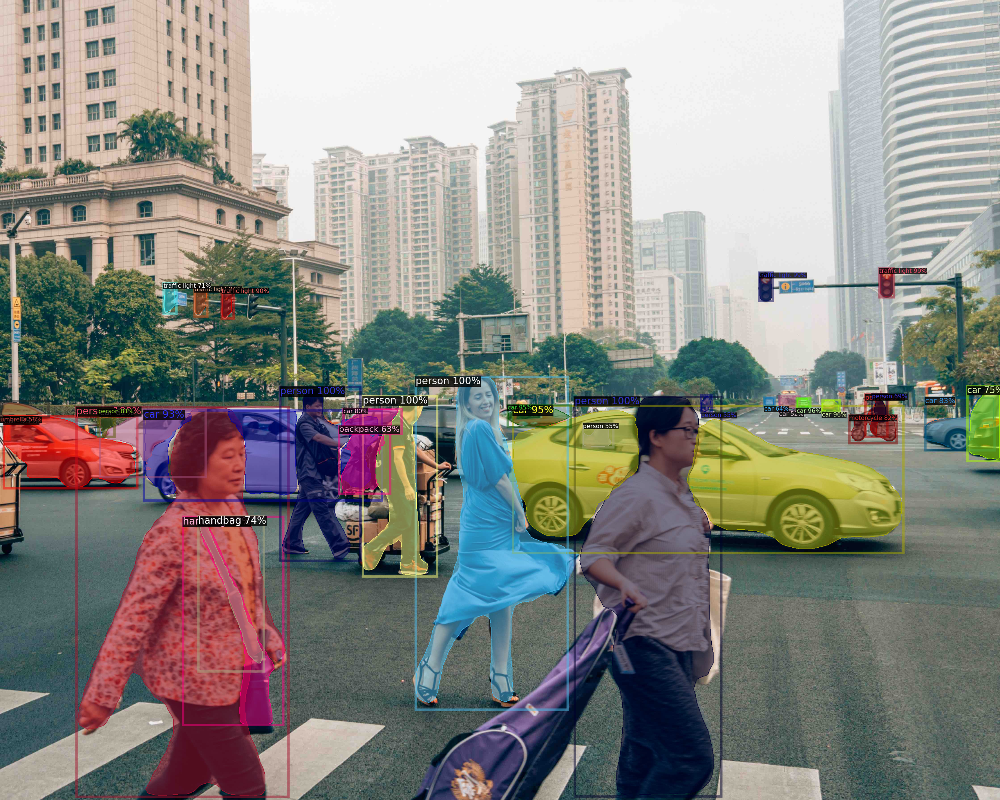

In [17]:
v = Visualizer(im[:, :, ::-1], MetadataCatalog.get(cfg.DATASETS.TRAIN[0]), scale=1.2)
v = v.draw_instance_predictions(outputs["instances"].to("cpu"))
cv2_imshow(v.get_image()[:, :, ::-1])

model_final_a6e10b.pkl: 237MB [00:17, 13.2MB/s]                           


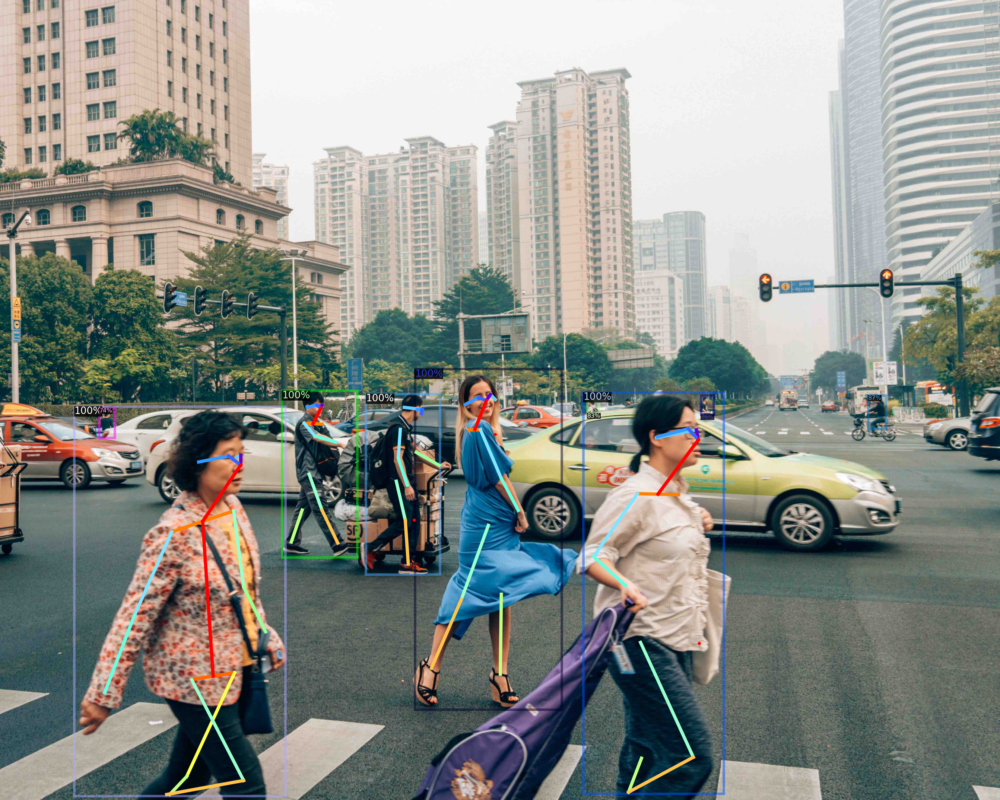

In [19]:
#Keypoint Detection Model
cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-Keypoints/keypoint_rcnn_R_50_FPN_3x.yaml"))
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.7
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-Keypoints/keypoint_rcnn_R_50_FPN_3x.yaml")
predictor = DefaultPredictor(cfg)
outputs = predictor(im)
v = Visualizer(im[:,:,::-1], MetadataCatalog.get(cfg.DATASETS.TRAIN[0]), scale=1.2)
v = v.draw_instance_predictions(outputs["instances"].to("cpu"))
cv2_imshow(v.get_image()[:, :, ::-1])

model_final_cafdb1.pkl: 261MB [00:22, 11.5MB/s]                           


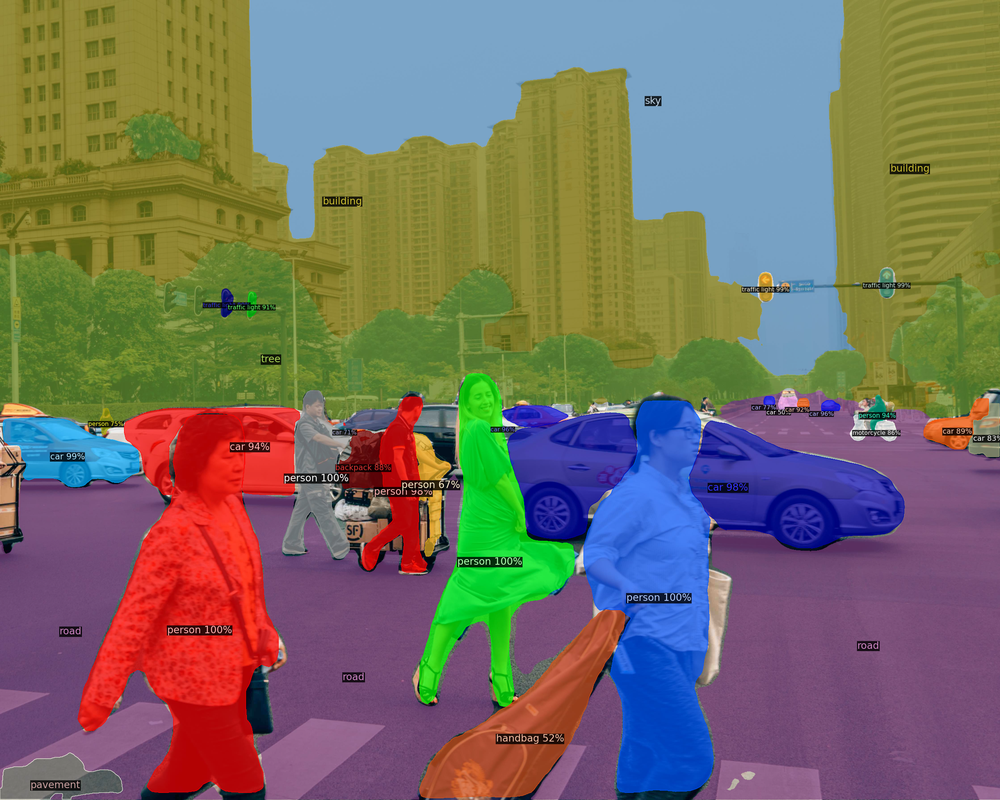

In [20]:
#Panoptic Segmentation Model
cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-PanopticSegmentation/panoptic_fpn_R_101_3x.yaml"))
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-PanopticSegmentation/panoptic_fpn_R_101_3x.yaml")
predictor = DefaultPredictor(cfg)
panoptic_seg, segments_info = predictor(im)["panoptic_seg"]
v = Visualizer(im[:, :, ::-1], MetadataCatalog.get(cfg.DATASETS.TRAIN[0]), scale=1.2)
v = v.draw_panoptic_seg_predictions(panoptic_seg.to("cpu"), segments_info)
cv2_imshow(v.get_image()[:, :, ::-1])